### Imports

In [12]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import imageio

#Some formatting things, feel free to change
import matplotlib as mpl
sns.set_palette('colorblind')
fontsize = 16
mpl.rcParams['axes.linewidth'] = 2.
mpl.rcParams['font.size'] = 16
mpl.rcParams['font.family'] = 'Times New Roman'
mpl.rcParams['text.usetex'] = True
mpl.rcParams['font.weight'] = 'light'

## Example 1

This first example inscribes a unit circle inside a square. By uniformly sampling points within the square, we can find $\pi$, because:
$$ 
A_{square} = 4 \\
A_{circle} = \pi \\
\Rightarrow \frac{A_{circle}}{A_{square}} = \frac{\pi}{4}
$$

So if we sample points uniformly in the square, then on average, $\pi \big/ 4$ of them will fall within the circle

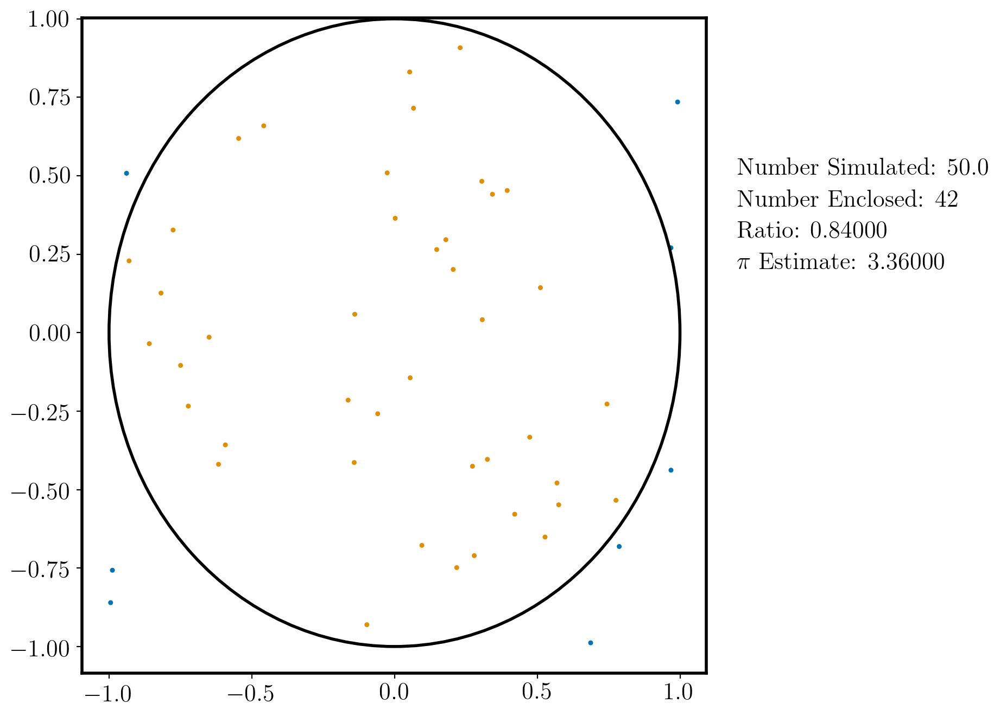

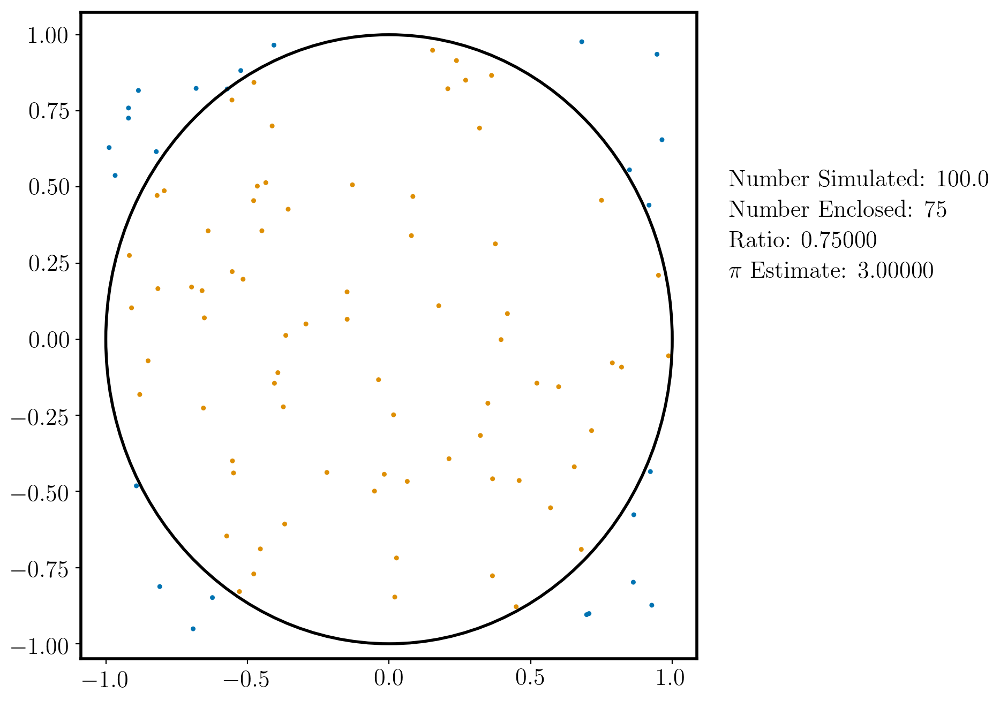

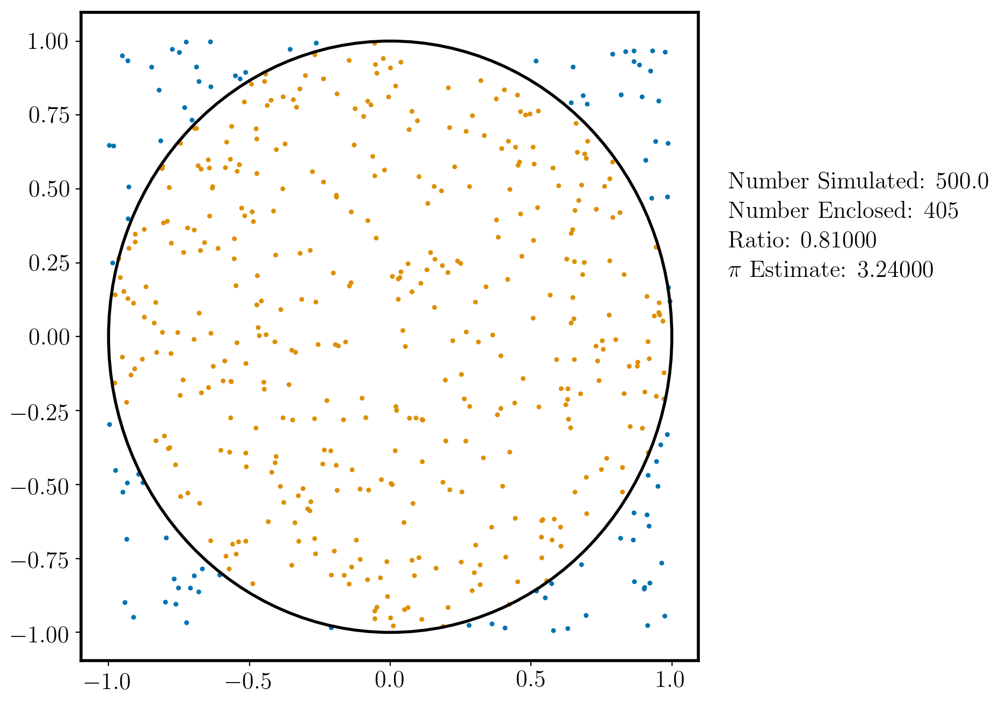

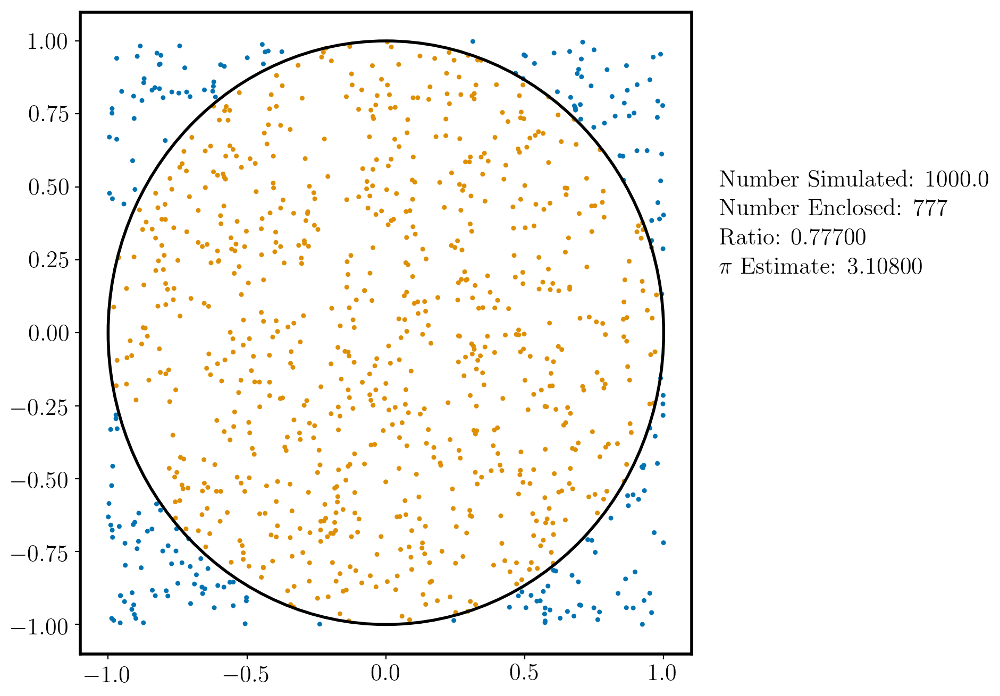

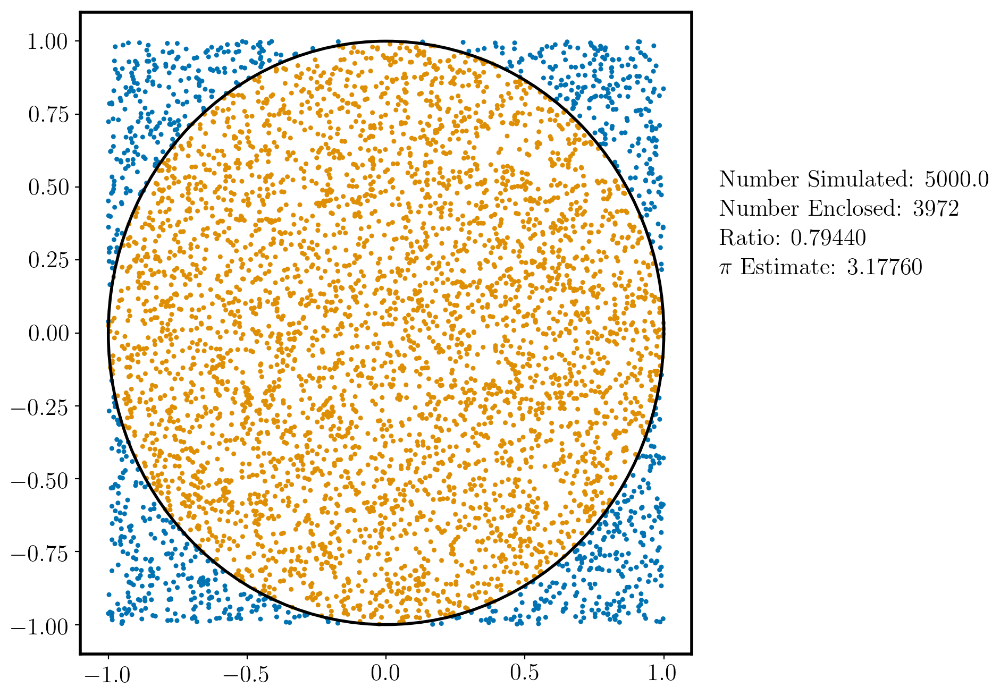

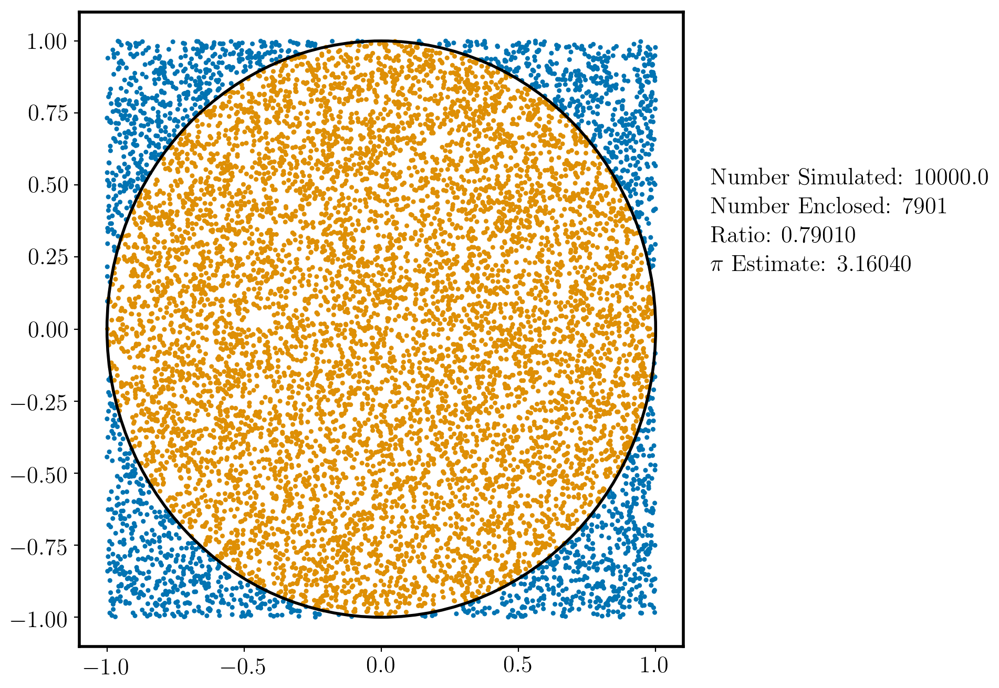

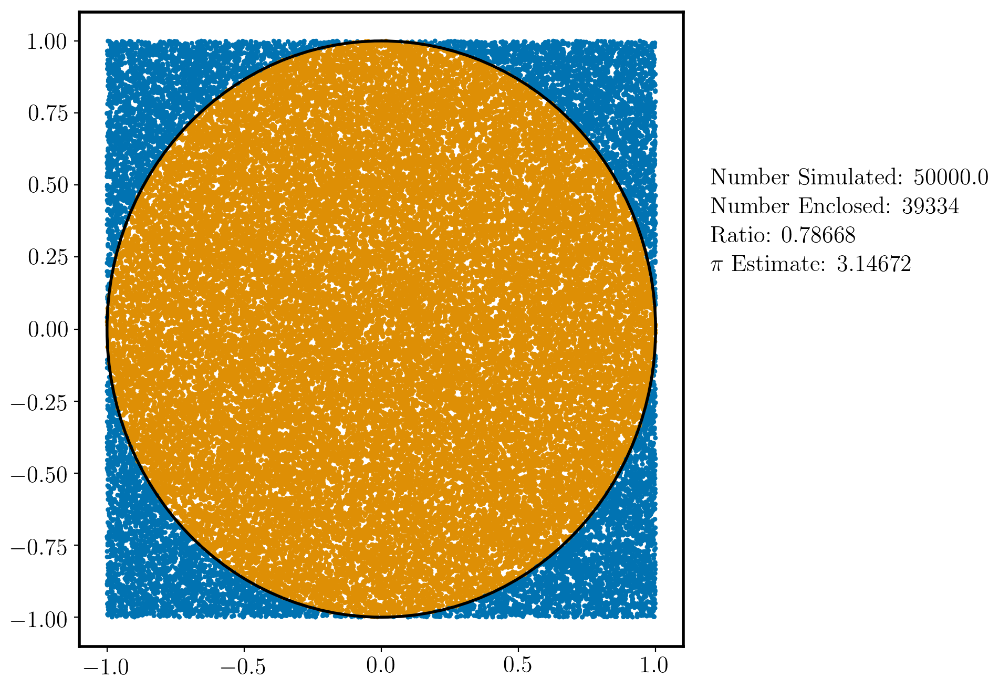

In [52]:
def plot_given_N(N):
    
    fig, ax = plt.subplots(figsize = (10,8), dpi = 200)
    plt.subplots_adjust(right = 0.7)
    
    x = np.random.uniform(low = -1., high = 1., size = int(N))
    y = np.random.uniform(low = -1., high = 1., size = int(N))
    inside = np.where(np.power(x,2) + np.power(y,2) <= 1., 1, 0)
    colors = [sns.color_palette()[k] for k in inside]
    num_enclosed = np.sum(inside)
    ratio = float(num_enclosed) / N

    ax.scatter(x, y, s = 5, c = colors )
    ax.add_patch(mpl.patches.Circle((0,0), radius = 1, edgecolor = 'k', fill = False, linewidth = 2))

    ax.text(1.2, 0.5, "Number Simulated: {}".format(N), fontsize = fontsize)
    ax.text(1.2, 0.4, "Number Enclosed: {}".format(num_enclosed), fontsize = fontsize)
    ax.text(1.2, 0.3, "Ratio: {:.5f}".format(ratio), fontsize = fontsize)
    ax.text(1.2, 0.2, r"$\pi$ Estimate: {:.5f}".format(ratio * 4.), fontsize = fontsize)
    
    fig.canvas.draw()
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    return image
vals = np.sort(np.append(np.logspace(1, 4, 4), 5*np.logspace(1, 4, 4)))[1:]

kwargs_write = {'fps':1.0, 'quantizer':'nq'}
imageio.mimsave('./dart_toss_pi.gif', [plot_given_N(i) for i in vals], fps = 1)

## Example 2: Buffon's Needle

If you repeatedly drop a needle of length $l$ onto a floor with floorboard spacing $d$, then you can approximate $\pi$ as $$\pi \approx \frac{2 l N}{rd}\; , $$
where $N$ is the number of needles you dropped and $r$ is the number of those trials where the needle crossed a floorboard boundary

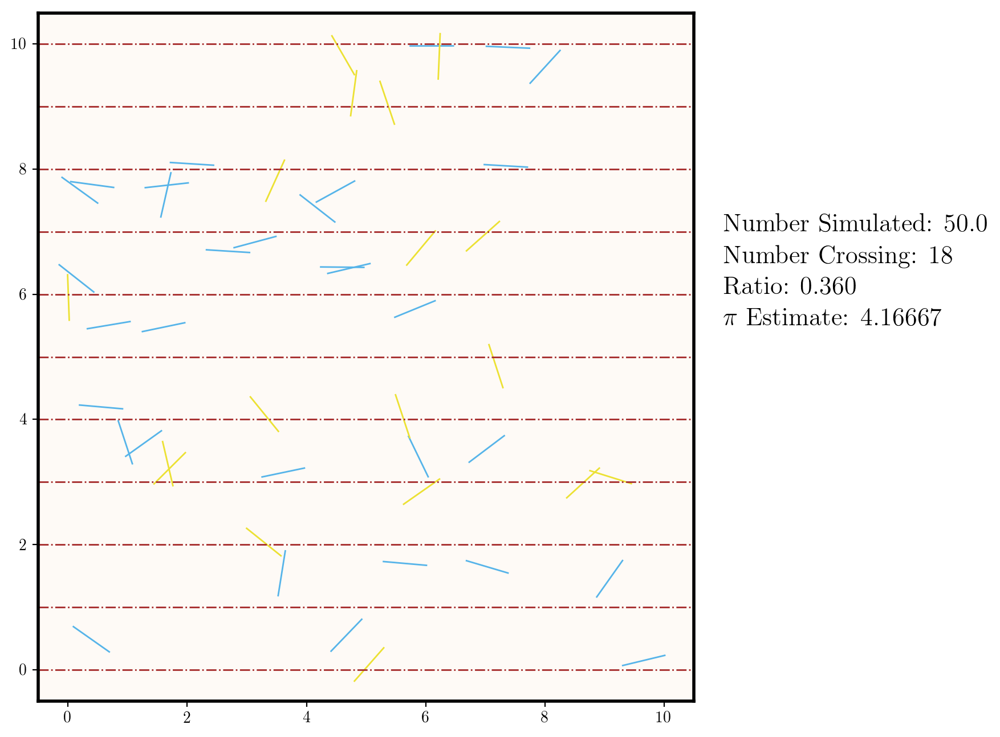

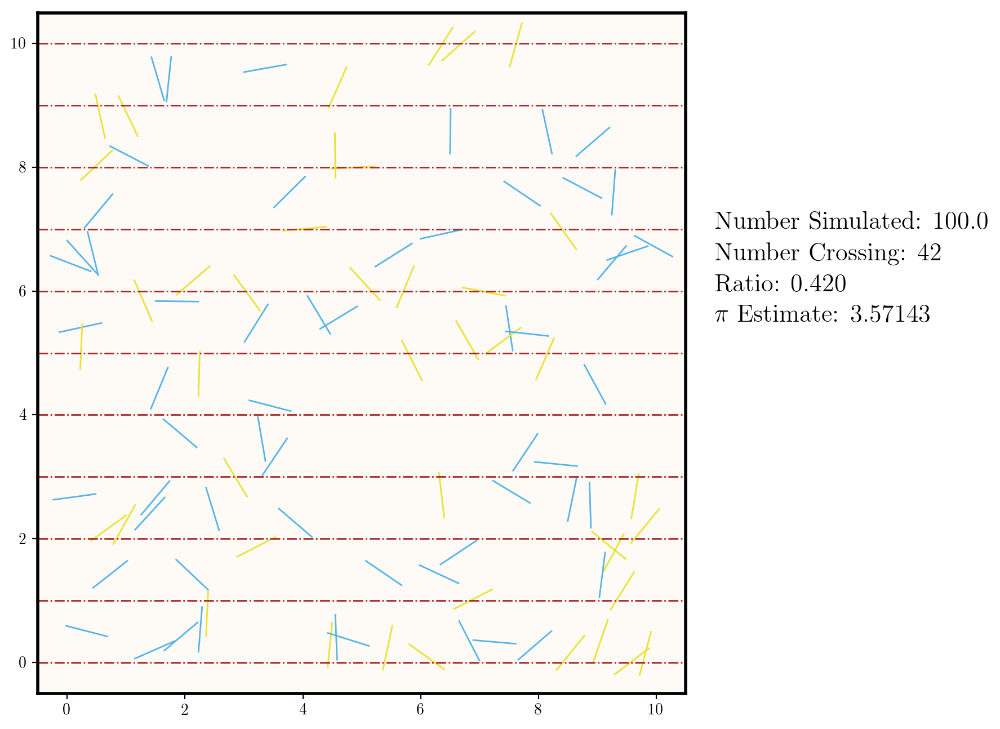

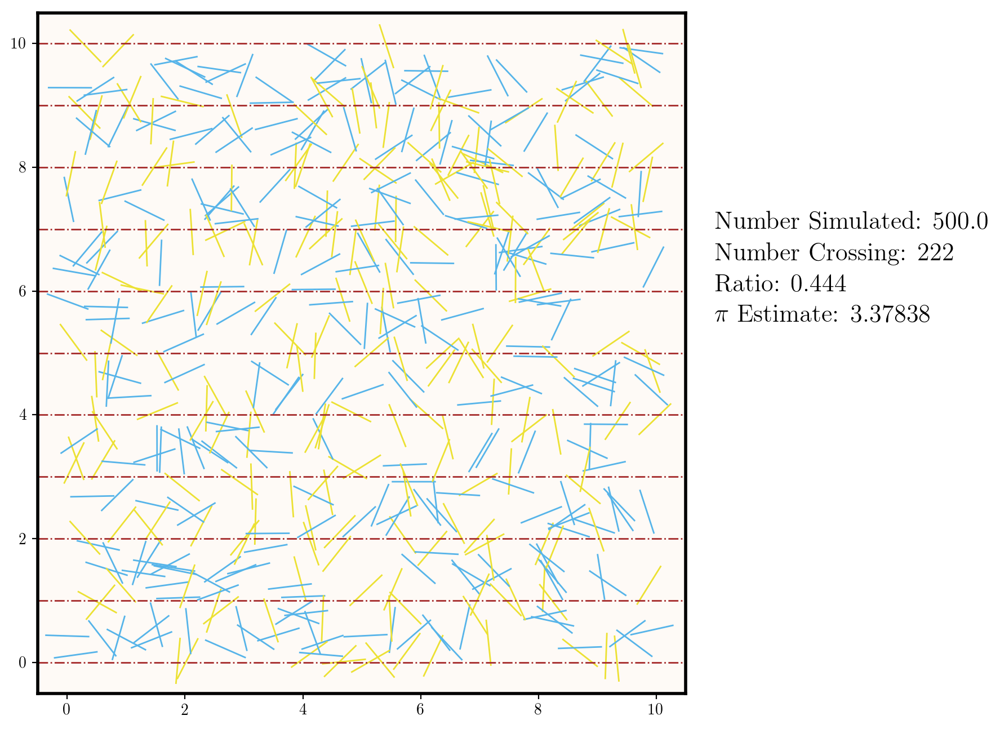

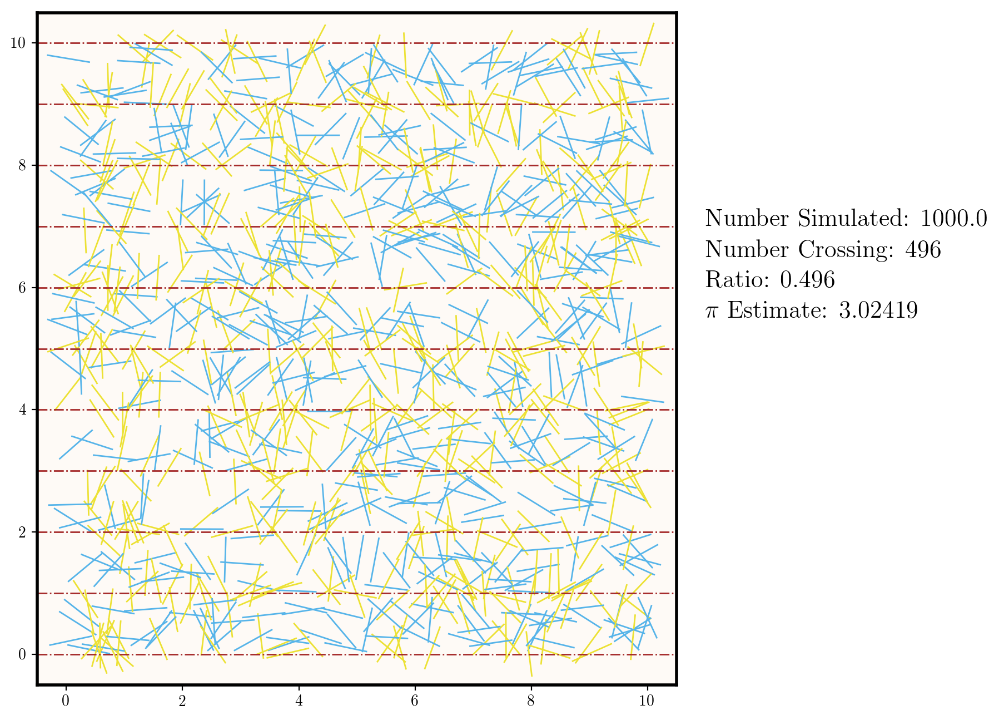

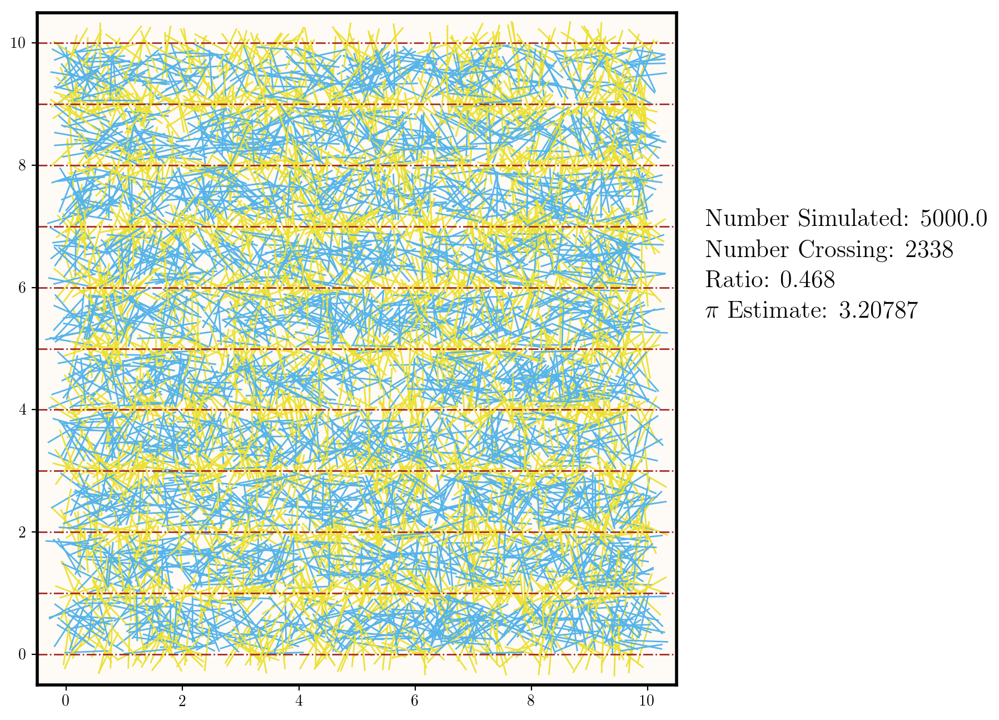

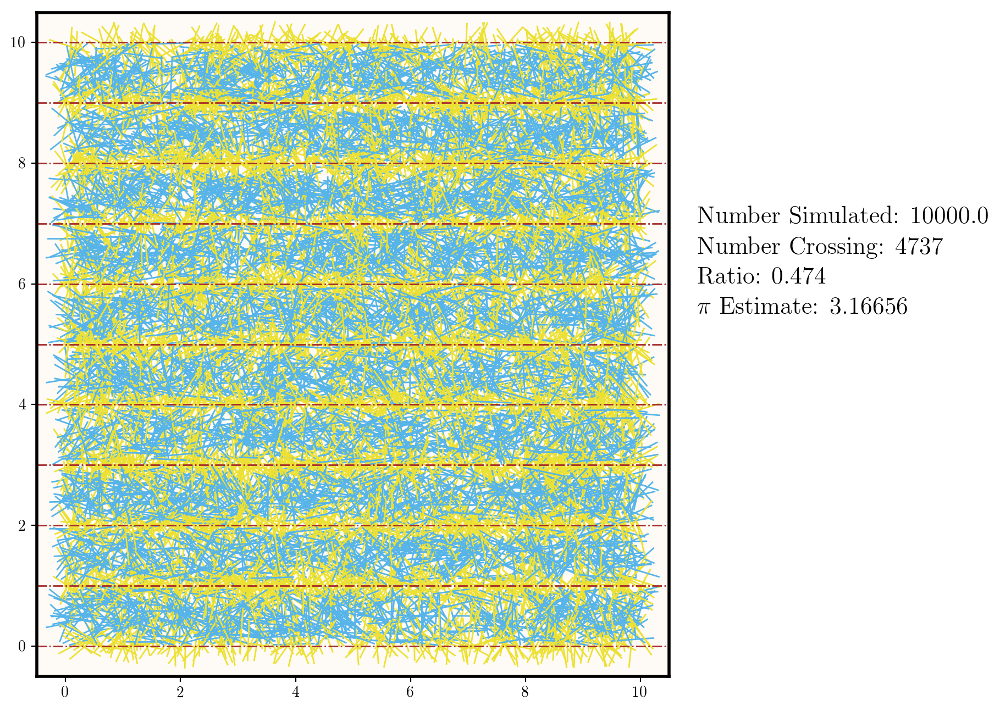

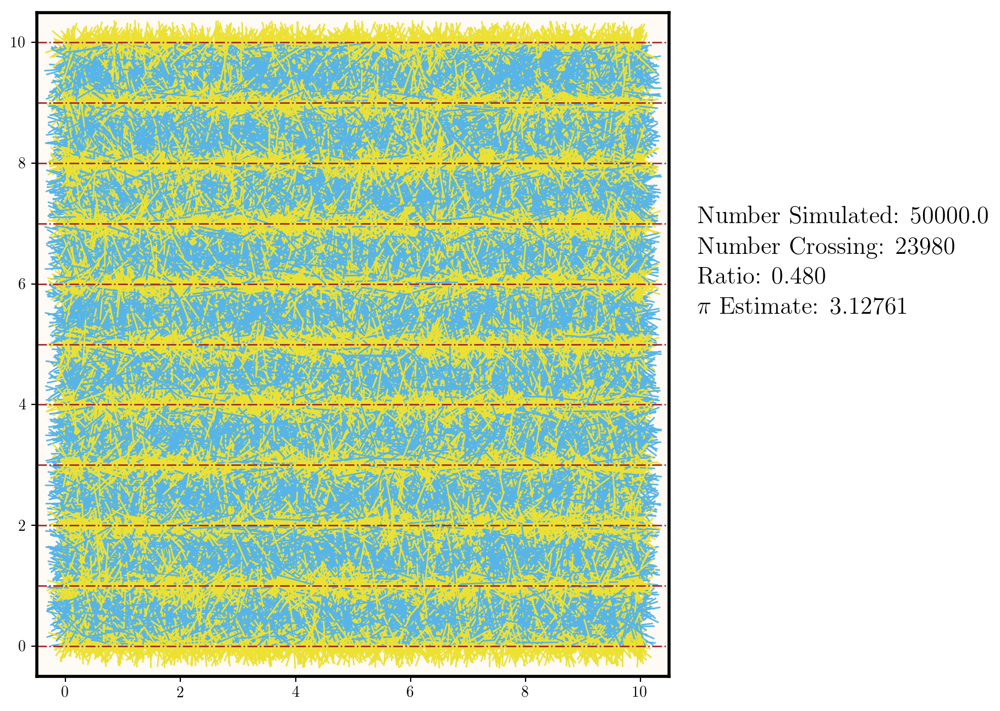

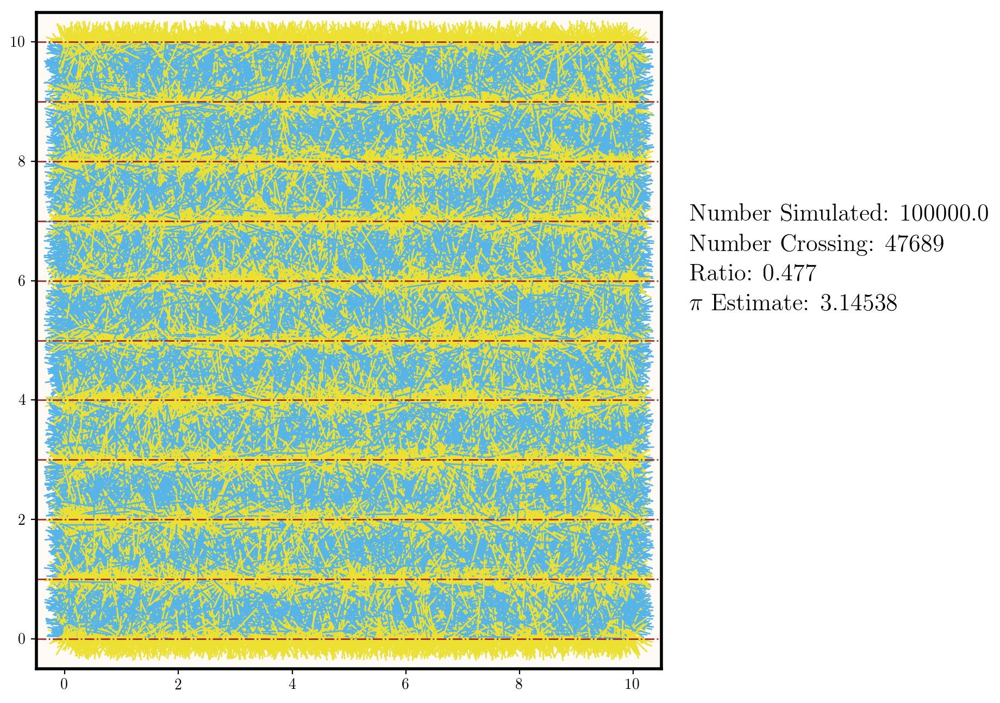

In [63]:
needle_l = 0.75

def buffon_needle(N):
    fig, ax = plt.subplots(figsize = (10,8), dpi = 200)
    plt.subplots_adjust(right = 0.7)

    for j in np.linspace(0., 10., 11):
        ax.axhline(j, linewidth = 1, linestyle = '-.', c = 'brown')

    plt.axhspan(-1, 11, color = 'sandybrown', alpha = 0.05)

    x = np.random.uniform(low = 0, high = 10, size = int(N))
    y = np.random.uniform(low = 0, high = 10, size = int(N))
    theta = np.random.uniform(low = 0, high = 2 * np.pi, size = int(N))

    x0 = x - 0.5*needle_l * np.cos(theta)
    x1 = x + 0.5*needle_l * np.cos(theta)
    y0 = y - 0.5*needle_l * np.sin(theta)
    y1 = y + 0.5*needle_l * np.sin(theta)

    lines = [[(a, b), (c, d)] for (a,b,c,d) in zip(x0, y0, x1, y1)]

    crossing = np.where((y1//1) - (y0//1) != 0, 1, 0)
    choice = [9, 8]
    colors = [sns.color_palette()[choice[k]] for k in crossing]

    lc = mpl.collections.LineCollection(lines, colors=colors, linewidths=1)
    ax.add_collection(lc)
    num_cross = np.sum(crossing)
    pi_est = 2 * N * needle_l * 1. / num_cross

    ax.text(11, 7,    "Number Simulated: {}".format(N), fontsize = fontsize)
    ax.text(11, 6.5,  "Number Crossing: {}".format(num_cross), fontsize = fontsize)
    ax.text(11, 6,    "Ratio: {:.3f}".format(num_cross / float(N)  ), fontsize = fontsize)
    ax.text(11, 5.5, r"$\pi$ Estimate: {:.5f}".format(pi_est), fontsize = fontsize)
    

    ax.set_ylim(-0.5, 10.5)
    ax.set_xlim(-0.5, 10.5)
    
    fig.canvas.draw()
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    return image

vals = np.sort(np.append(np.logspace(1, 5, 5), 5*np.logspace(1, 4, 4)))[1:]

kwargs_write = {'fps':1.0, 'quantizer':'nq'}
imageio.mimsave('./buffons_needle_pi.gif', [buffon_needle(i) for i in vals], fps = 1)

## Example 3: Random Walk

This one is a consequence of the Central Limit Theorem. If you flip a coin, and for every time you get a heads, you take a step forward, and every time you get a tails, you take a step backwards, then you are doing what is called a one dimensional random walk. Now, do this many, many times, and after each walk record how far away you are from where you started. If you calculate the average of that, and call it $\mu$, then you can calculate $\pi$ using 
$$\pi \approx \frac{2 \cdot steps}{\mu^2} $$
where $steps$ is the number of steps you took in each random walk. This is because of a beautiful result called the Central Limit Theorem, which says that a lot of random processes end up having properties that look like Gaussians (bell curves), and the integral (area under the curve) of a Gaussian is related to $\pi$.

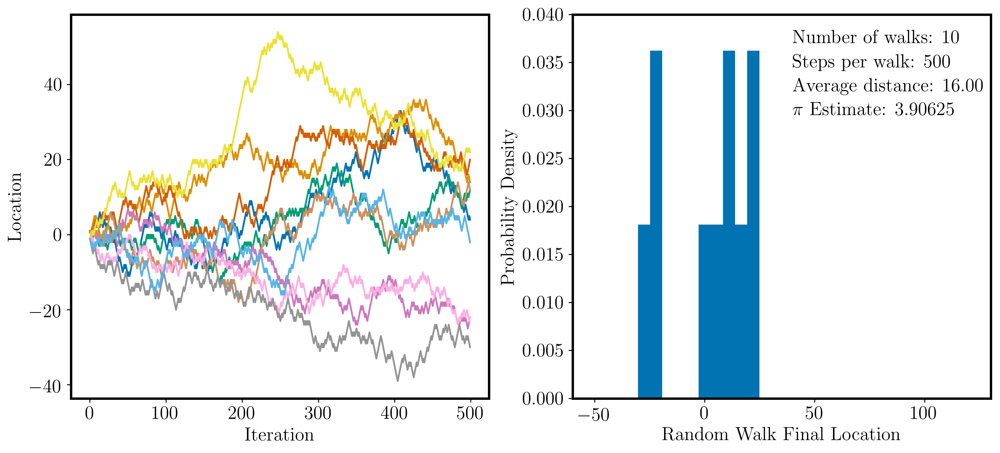

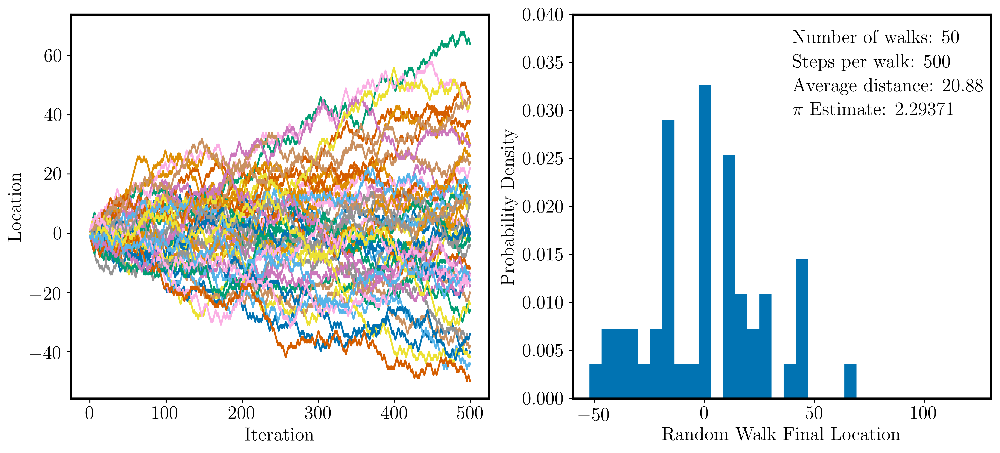

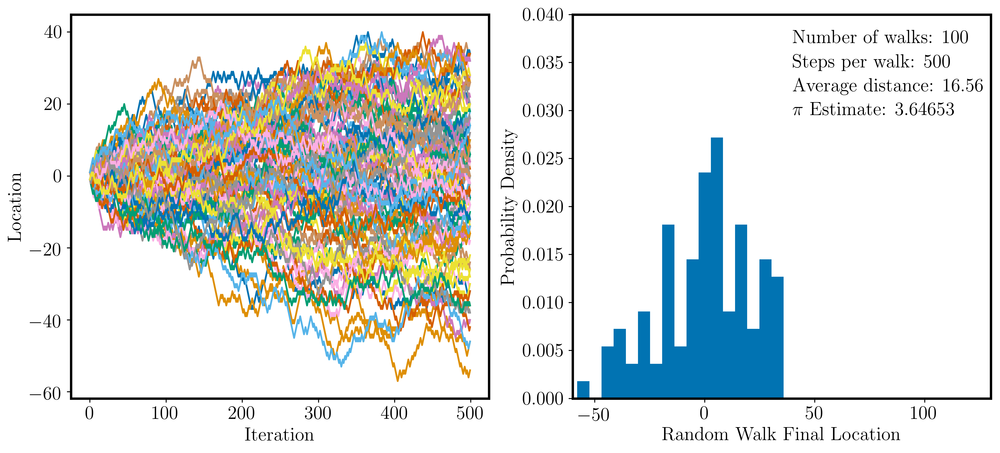

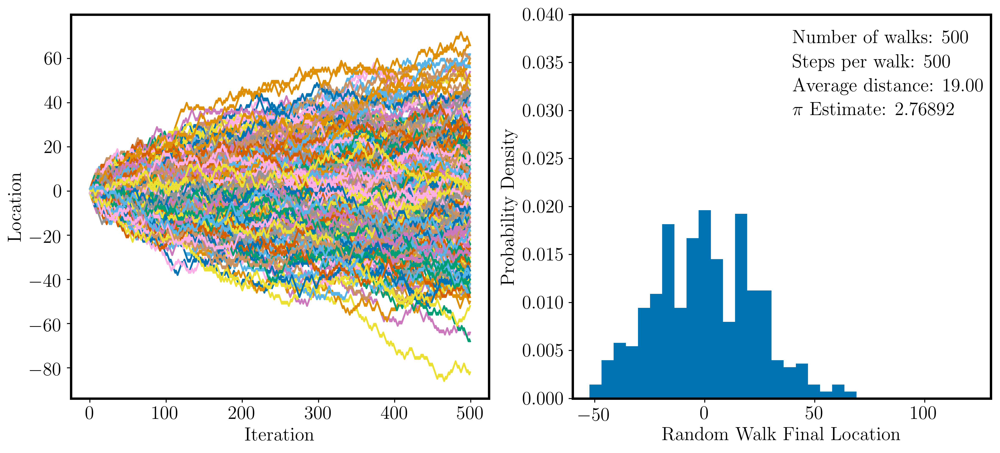

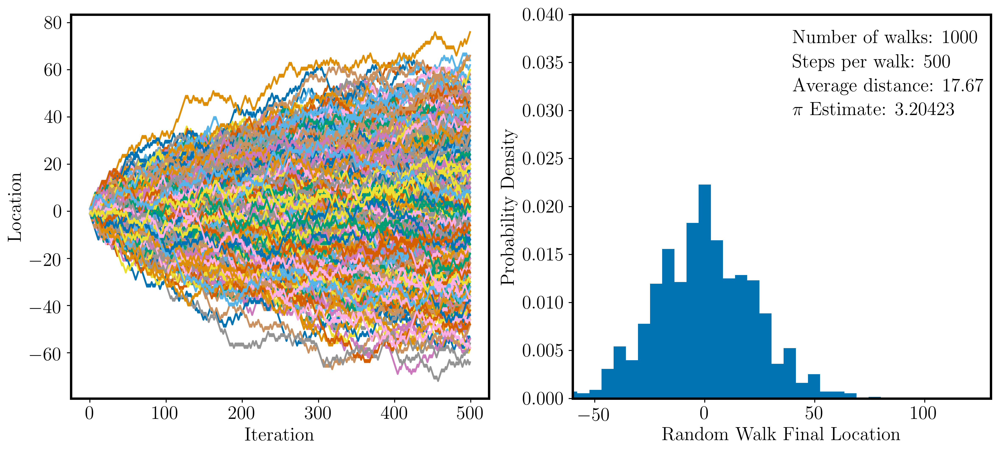

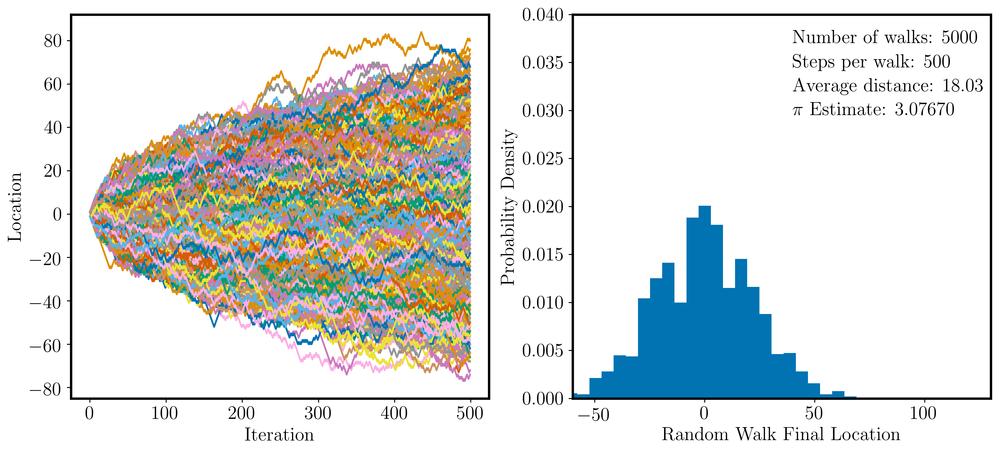

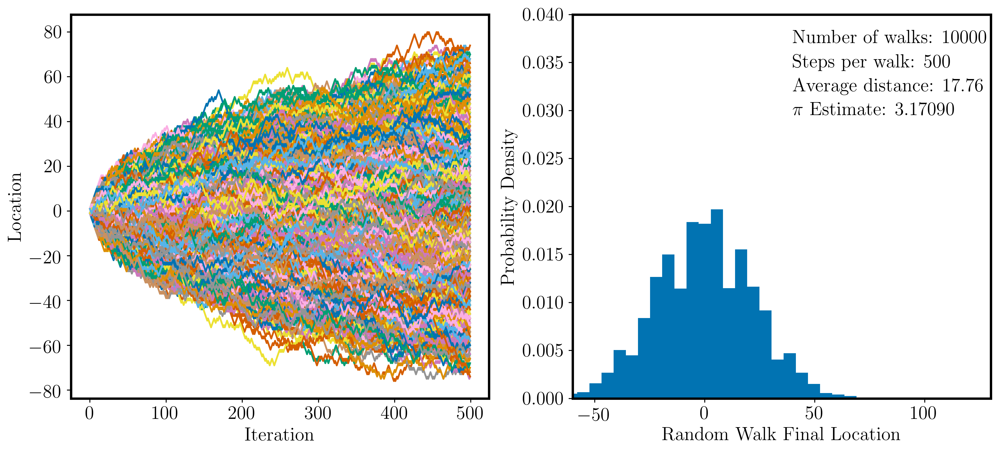

In [ ]:
def rand_walk(steps):
    random_walk = np.random.choice([1,-1], size = steps)
    walk_sum = [np.sum(random_walk[:n]) for n in range(1, len(random_walk) + 1)]
    return walk_sum

def plot_walks(steps, N):
    a = np.array([rand_walk(steps) for i in range(N)])
    finals = [a[k,-1] for k in range(len(a))]
    final_ave = np.average(np.absolute(finals))
    pi_est = 2 * steps / np.power(final_ave, 2.)
    
    fig, ax = plt.subplots(1,2, figsize = (14,6), dpi = 400)

    plt.subplot(121)
    plt.plot(a.T)
    plt.xlabel("Iteration", fontsize = fontsize)
    plt.ylabel('Location', fontsize = fontsize)

    plt.subplot(122)
    plt.xlabel("Random Walk Final Location", fontsize = fontsize)
    plt.ylabel("Probability Density", fontsize = fontsize)
    plt.ylim(0., 0.04)
    plt.hist(finals, bins = np.linspace(-80, 80, 30), density = True)

    plt.text(40, 0.0370, "Number of walks: {}".format(N))
    plt.text(40, 0.0345, "Steps per walk: {}".format(steps))
    plt.text(40, 0.0320, 'Average distance: {:.2f}'.format(final_ave), fontsize = fontsize)
    plt.text(40, 0.0295, r'$\pi$ Estimate: {:.5f}'.format(pi_est), fontsize = fontsize)

    plt.xlim(-60, 130)
    
    fig.canvas.draw()
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    return image

vals = np.sort(np.append(np.logspace(1, 4, 4), 5*np.logspace(1, 4, 4)))

ims = [plot_walks(500, int(i)) for i in vals]

ims.append(ims[-1])


kwargs_write = {'fps':1.0, 'quantizer':'nq'}
imageio.mimsave('./random_walk_pi.gif', ims, fps = 0.67)

## Example 4: 2D Random Walk

Almost the same as example 3, but now for a lattice random walk. Here, you get 
$$\pi \approx \frac{4 d^2}{steps} $$
where $d$ is the Euclidean distance between the origin and the ending location

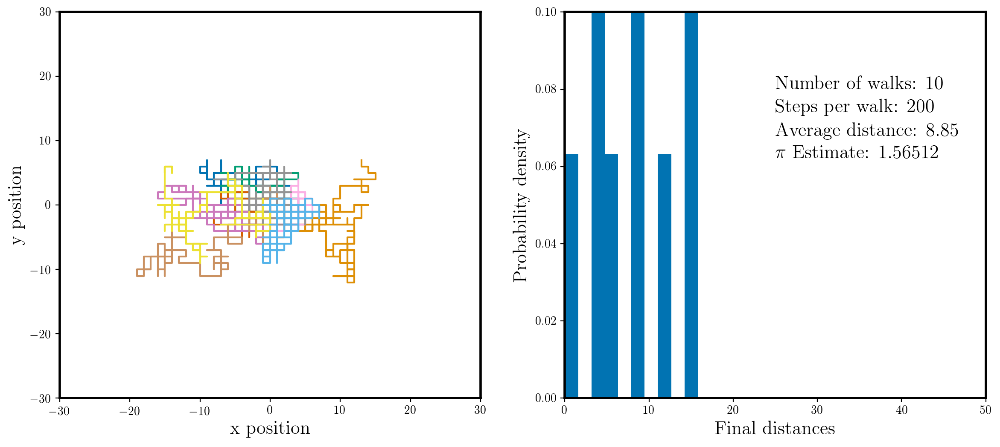

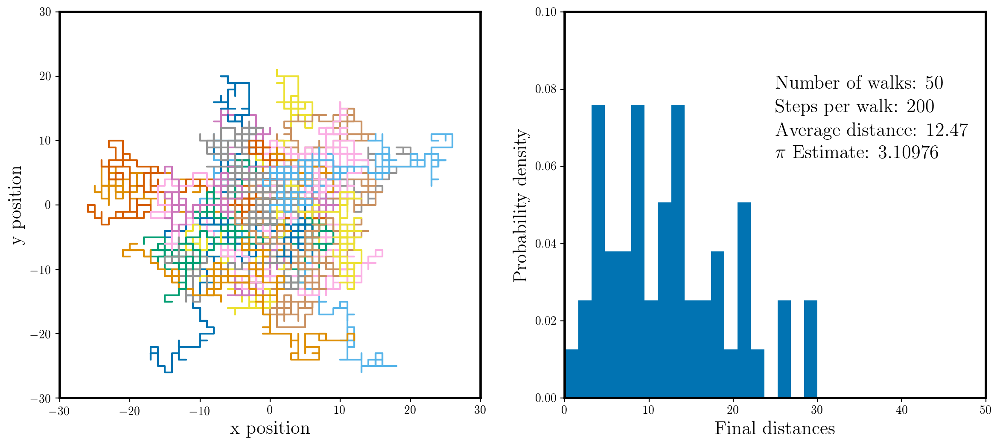

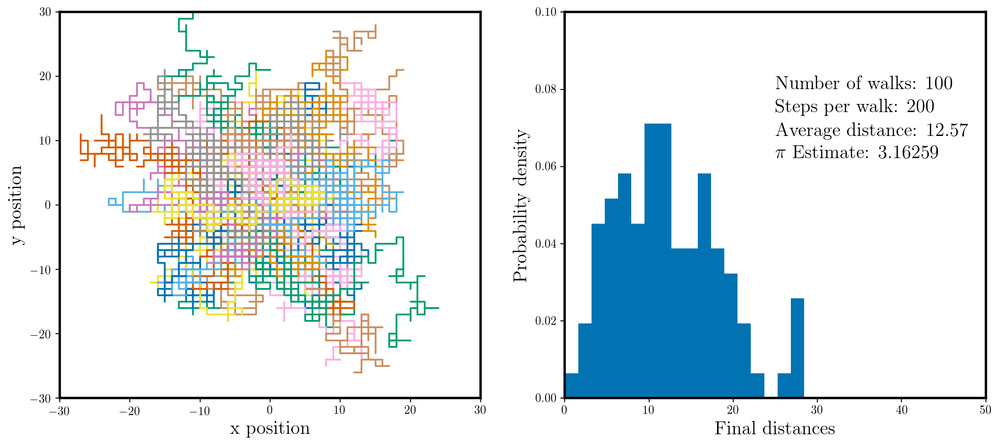

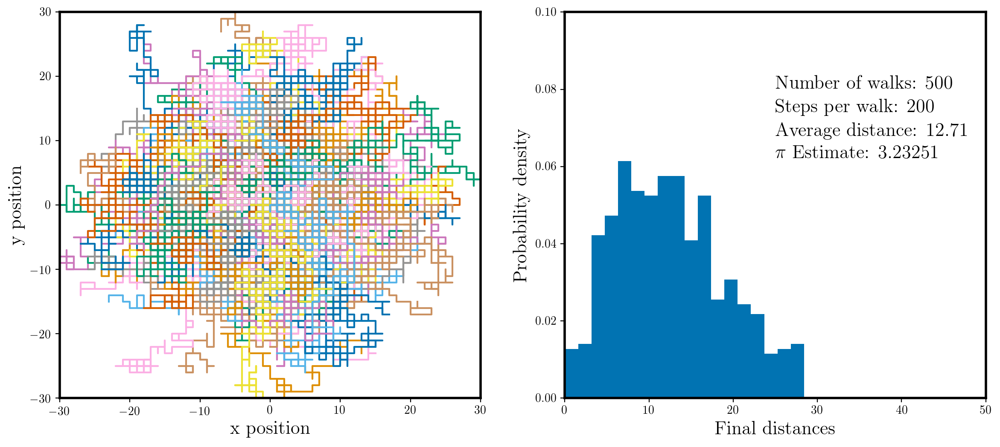

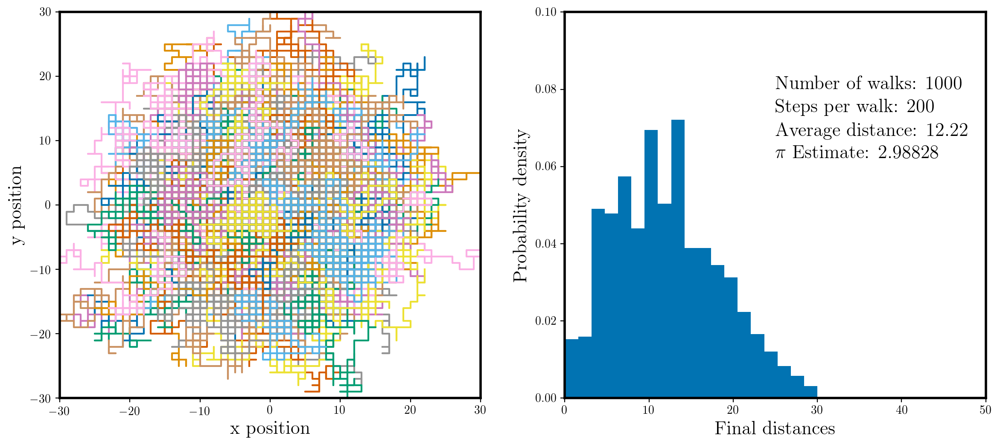

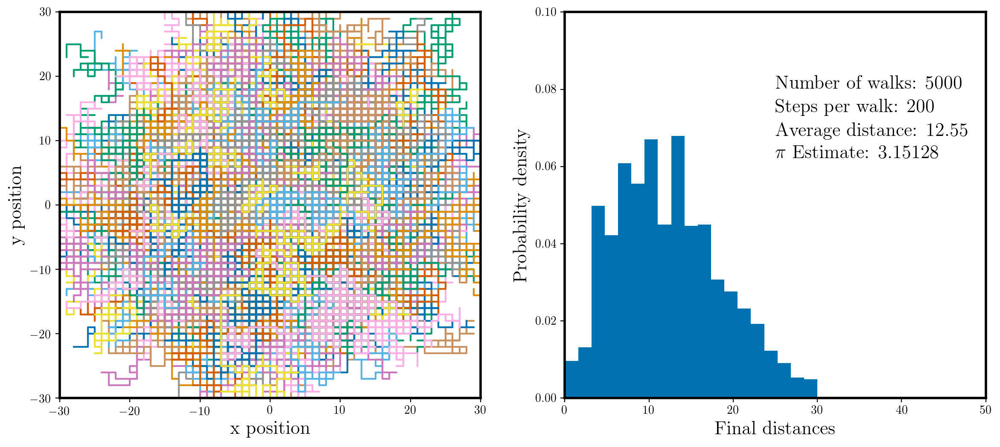

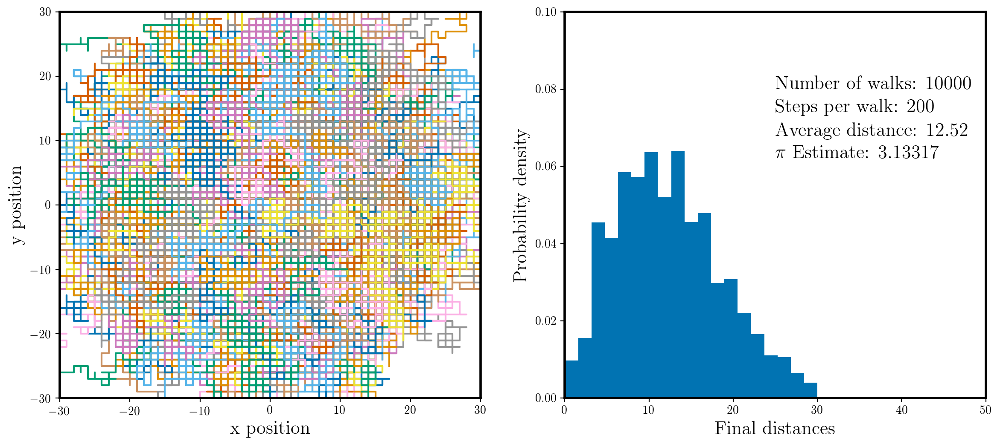

In [81]:
def rand_walk_2d(steps):
    twod_walk = np.random.choice([1,2,3,4], size = steps)
    x = np.zeros(steps + 1)
    y = np.zeros(steps + 1)
    for j in range(1, steps + 1):
        if twod_walk[j-1] == 1:
            x[j] = x[j-1] + 1
            y[j] = y[j-1]
        elif twod_walk[j-1] == 2:
            x[j] = x[j-1] - 1
            y[j] = y[j-1]
        elif twod_walk[j-1] == 3:
            x[j] = x[j-1] 
            y[j] = y[j-1] + 1
        else:
            x[j] = x[j-1] 
            y[j] = y[j-1] - 1
    x, y = np.array(x), np.array(y)
    return x, y

def plot_walks_2d(steps, N):
    x, y = [], []
    fig, ax = plt.subplots(1,2, figsize = (14,6), dpi=200)
    for ii in range(N):
        xi, yi = rand_walk_2d(steps)
        x.append(xi)
        y.append(yi)
    x = np.array(x)
    y = np.array(y)
    
    plt.subplot(121)
    plt.plot(x.T, y.T)
    plt.xlim(-30,30)
    plt.ylim(-30,30)
    plt.xlabel("x position", fontsize = fontsize)
    plt.ylabel("y position", fontsize = fontsize)
    
    plt.subplot(122)
    dists_x = x[:,-1]
    dists_y = y[:,-1]
    dists = np.power(np.power(dists_x, 2.) + np.power(dists_y, 2.), 0.5)
    ave_dist = np.average(dists)
    pi_est = 4 * ave_dist**2 / steps
    
    plt.hist(dists, bins = np.linspace(0., 30., 20), density = True)
    plt.xlabel("Final distances", fontsize = fontsize)
    plt.ylabel("Probability density", fontsize = fontsize)
    plt.xlim(0, 50)
    plt.ylim(0, 0.10)
    plt.text(25, 0.08, "Number of walks: {}".format(N), fontsize = fontsize)
    plt.text(25, 0.074, "Steps per walk: {}".format(steps), fontsize = fontsize)
    plt.text(25, 0.068, 'Average distance: {:.2f}'.format(ave_dist), fontsize = fontsize)
    plt.text(25, 0.062, r'$\pi$ Estimate: {:.5f}'.format(pi_est), fontsize = fontsize)

    fig.canvas.draw()
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))

    return image

vals = np.sort(np.append(np.logspace(1, 4, 4), 5*np.logspace(1, 3, 3)))
    
ims = [plot_walks_2d(200, int(i)) for i in vals]
ims.append(ims[-1])

kwargs_write = {'fps':1.0, 'quantizer':'nq'}
imageio.mimsave('./random_walk_2d_pi_dpi200.gif', ims, fps = 0.67)
    